# Proyecto de clustering de segmentación de actividad con Apple Watch y Fit Bit


## Importar librerías

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as  sns

## Carga de datos

In [2]:
data = pd.read_csv('aw_fb_data.csv', sep=",", index_col="Unnamed: 0")

In [3]:
data.describe()

,X1,age,gender,height,weight,steps,hear_rate,calories,distance,entropy_heart,entropy_setps,resting_heart,corr_heart_steps,norm_heart,intensity_karvonen,sd_norm_heart,steps_times_distance
count,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000,6264.000000
mean,1771.144317,29.158525,0.476533,169.709052,69.614464,109.562268,86.142331,19.471823,13.832555,6.030314,5.739984,65.869938,0.306447,20.272393,0.155479,8.110854,590.035239
std,1097.988748,8.908978,0.499489,10.324698,13.451878,222.797908,28.648385,27.309765,45.941437,0.765574,1.256348,21.203017,0.775418,28.388116,0.210927,12.535080,4063.838530
min,1.000000,18.000000,0.000000,143.000000,43.000000,1.000000,2.222222,0.056269,0.000440,0.000000,0.000000,3.000000,-1.000000,-76.000000,-2.714286,0.000000,0.000690
25%,789.750000,23.000000,0.000000,160.000000,60.000000,5.159534,75.598079,0.735875,0.019135,6.108524,5.909440,58.134333,-0.467303,1.148883,0.009819,0.264722,0.659260
50%,1720.000000,28.000000,0.000000,168.000000,68.000000,10.092029,77.267680,4.000000,0.181719,6.189825,6.157197,75.000000,0.665829,9.820254,0.079529,2.893503,13.368619
75%,2759.250000,33.000000,1.000000,180.000000,77.300000,105.847222,95.669118,20.500000,15.697188,6.247928,6.247928,76.138701,1.000000,27.077336,0.211868,9.679672,93.728562
max,3670.000000,56.000000,1.000000,191.000000,115.000000,1714.000000,194.333333,97.500000,335.000000,6.475733,6.475733,155.000000,1.000000,156.319444,1.297980,74.457929,51520.000000


## Manejando valores nulos

In [4]:
data.isnull().sum()

X1                      0
age                     0
gender                  0
height                  0
weight                  0
steps                   0
hear_rate               0
calories                0
distance                0
entropy_heart           0
entropy_setps           0
resting_heart           0
corr_heart_steps        0
norm_heart              0
intensity_karvonen      0
sd_norm_heart           0
steps_times_distance    0
device                  0
activity                0
dtype: int64

## Validando duplicados

In [5]:
data[data.duplicated()]

,X1,age,gender,height,weight,steps,hear_rate,calories,distance,entropy_heart,entropy_setps,resting_heart,corr_heart_steps,norm_heart,intensity_karvonen,sd_norm_heart,steps_times_distance,device,activity


## Eliminando columnas según la consigna

In [6]:
data = data.drop('X1', axis=1)

## Cardinalizando Activity para optimizar

In [7]:
activity_order = {
    "Lying": 0,
    "Sitting": 1,
    "Self Pace walk": 2,
    "Running 3 METs": 3,
    "Running 5 METs": 4,
    "Running 7 METs": 5
}

data['activity_order'] = data['activity'].map(activity_order)
data.drop(columns="activity",inplace=True)

## Haciendo get dummies

In [8]:
data = pd.get_dummies(data, drop_first=True)
data.head()

,age,gender,height,weight,steps,hear_rate,calories,distance,entropy_heart,entropy_setps,resting_heart,corr_heart_steps,norm_heart,intensity_karvonen,sd_norm_heart,steps_times_distance,activity_order,device_fitbit
1,20,1,168.0,65.4,10.771429,78.531302,0.344533,0.008327,6.221612,6.116349,59.0,1.000000,19.531302,0.138520,1.000000,0.089692,0,False
2,20,1,168.0,65.4,11.475325,78.453390,3.287625,0.008896,6.221612,6.116349,59.0,1.000000,19.453390,0.137967,1.000000,0.102088,0,False
3,20,1,168.0,65.4,12.179221,78.540825,9.484000,0.009466,6.221612,6.116349,59.0,1.000000,19.540825,0.138587,1.000000,0.115287,0,False
4,20,1,168.0,65.4,12.883117,78.628260,10.154556,0.010035,6.221612,6.116349,59.0,1.000000,19.628260,0.139208,1.000000,0.129286,0,False
5,20,1,168.0,65.4,13.587013,78.715695,10.825111,0.010605,6.221612,6.116349,59.0,0.982816,19.715695,0.139828,0.241567,0.144088,0,False


In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6264 entries, 1 to 6264
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   age                   6264 non-null   int64  
 1   gender                6264 non-null   int64  
 2   height                6264 non-null   float64
 3   weight                6264 non-null   float64
 4   steps                 6264 non-null   float64
 5   hear_rate             6264 non-null   float64
 6   calories              6264 non-null   float64
 7   distance              6264 non-null   float64
 8   entropy_heart         6264 non-null   float64
 9   entropy_setps         6264 non-null   float64
 10  resting_heart         6264 non-null   float64
 11  corr_heart_steps      6264 non-null   float64
 12  norm_heart            6264 non-null   float64
 13  intensity_karvonen    6264 non-null   float64
 14  sd_norm_heart         6264 non-null   float64
 15  steps_times_distance  6264

## Análisis de distribución

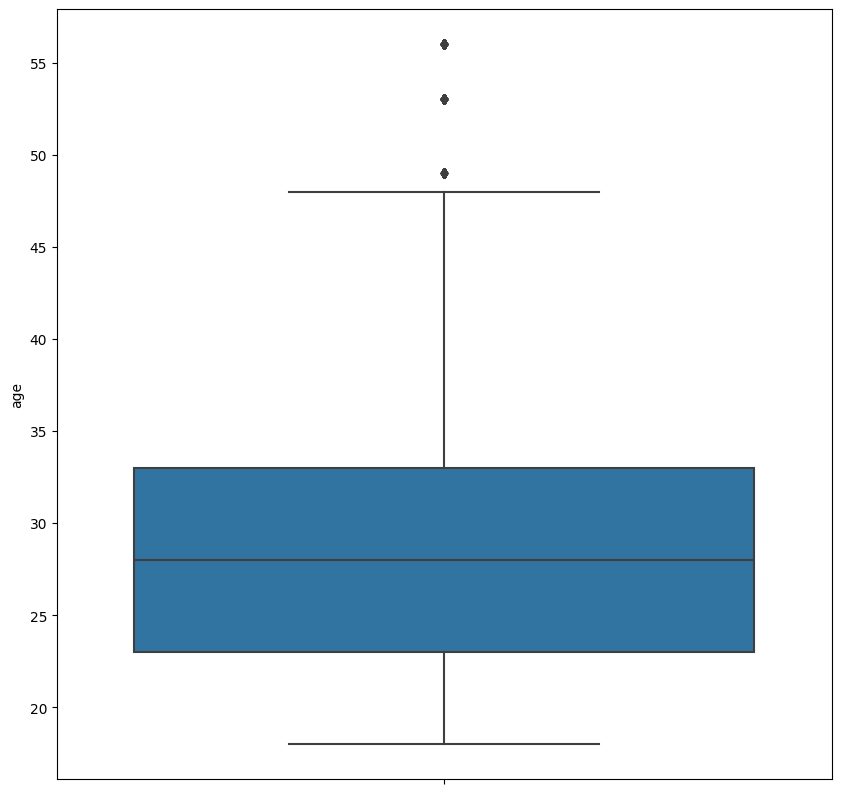

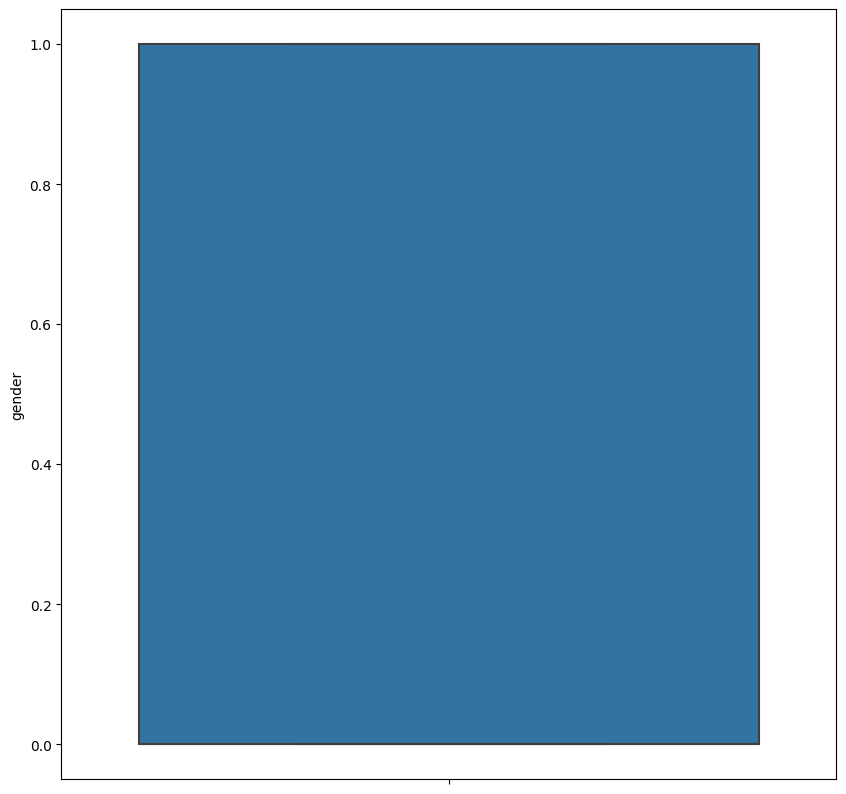

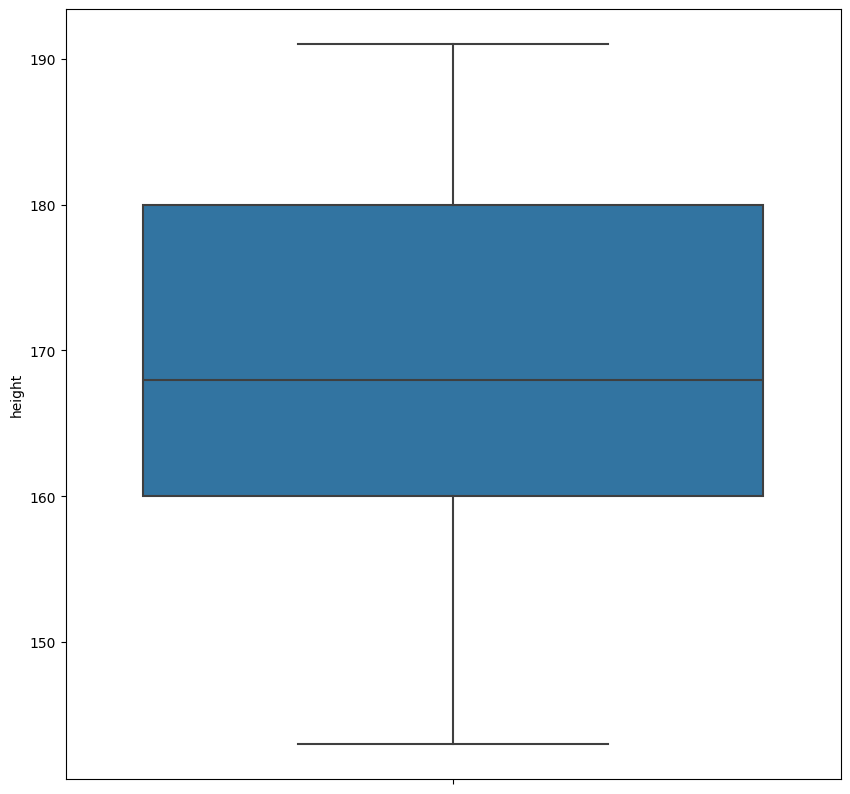

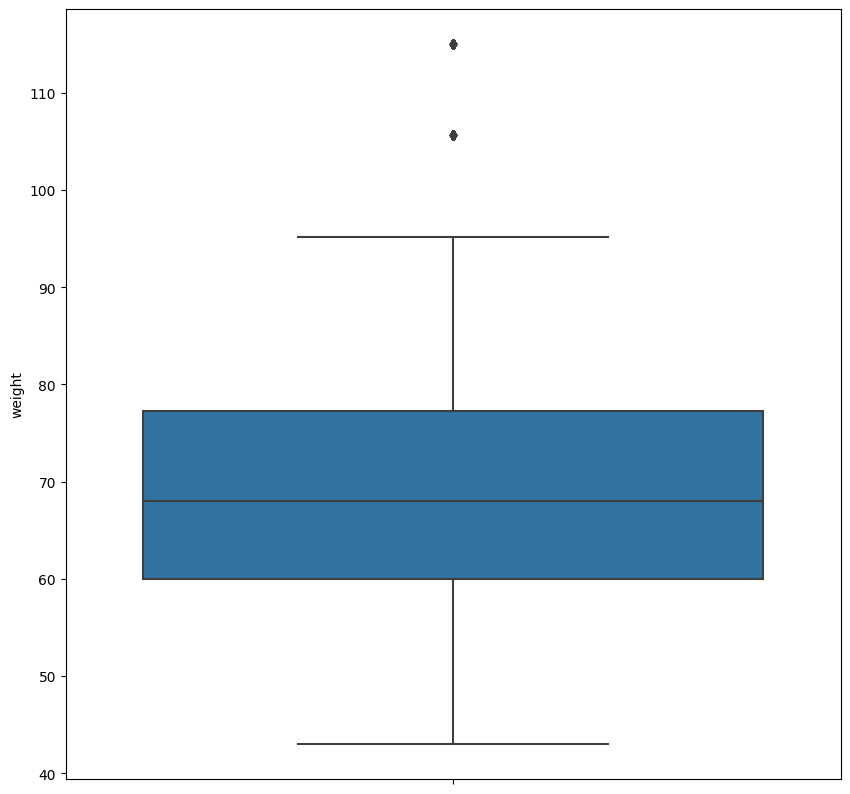

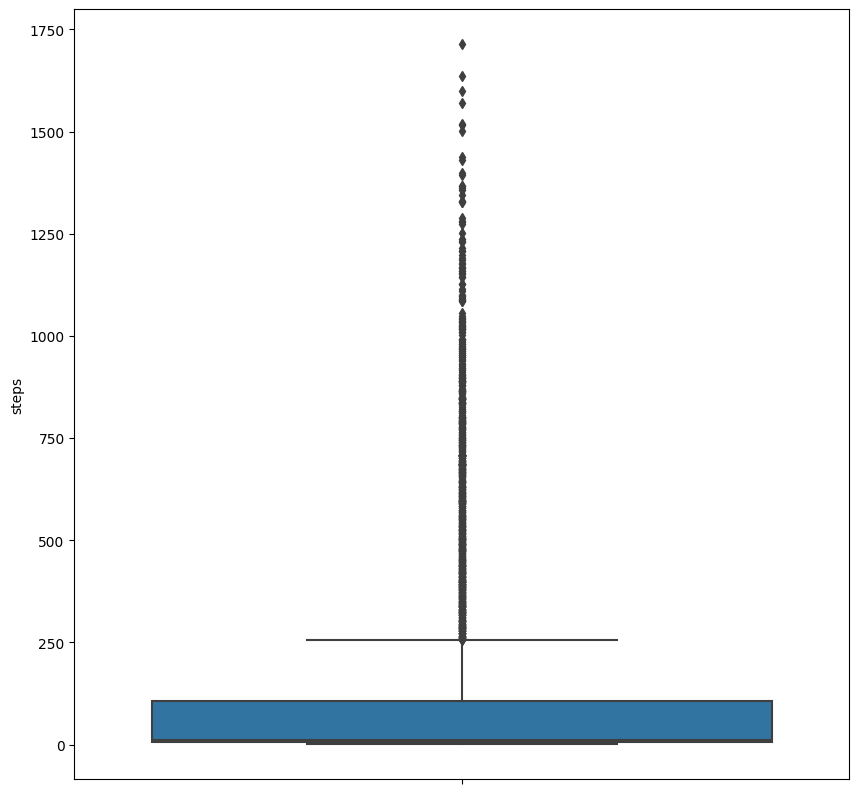

...

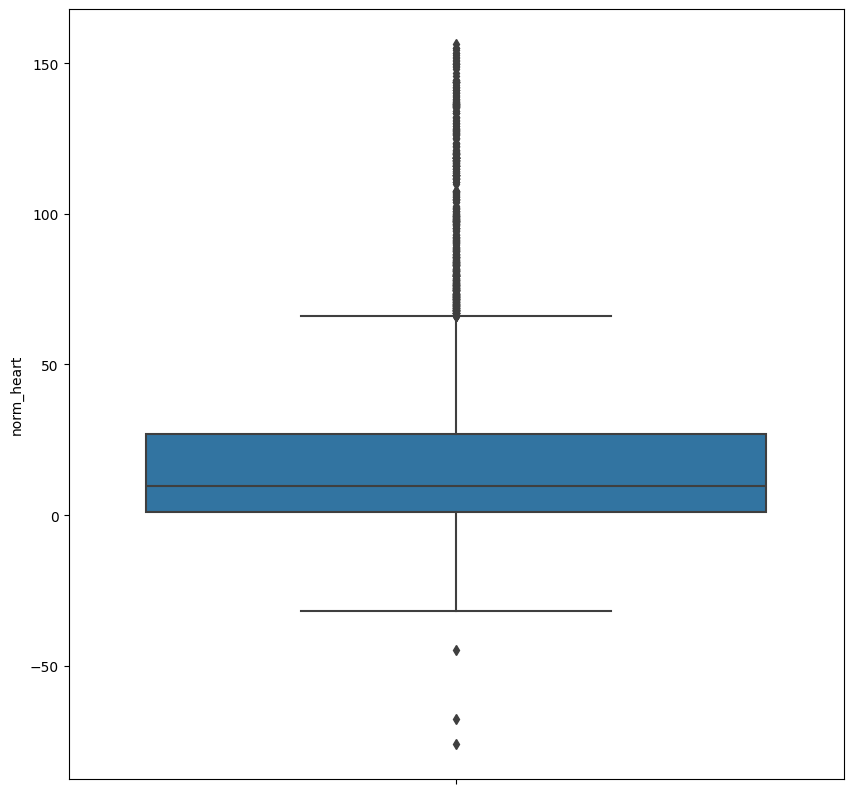

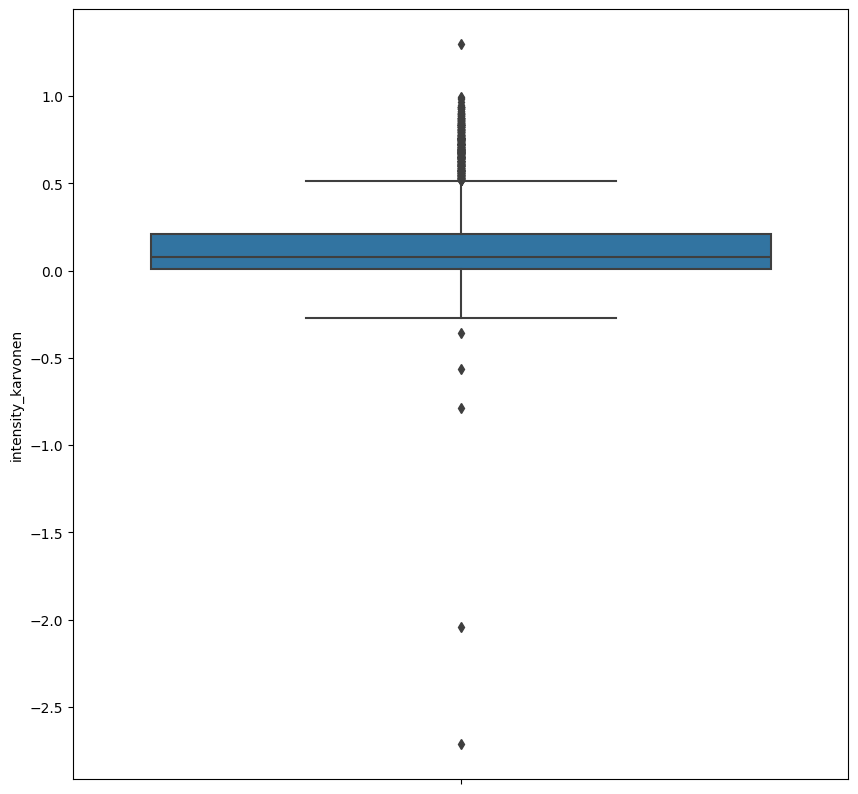

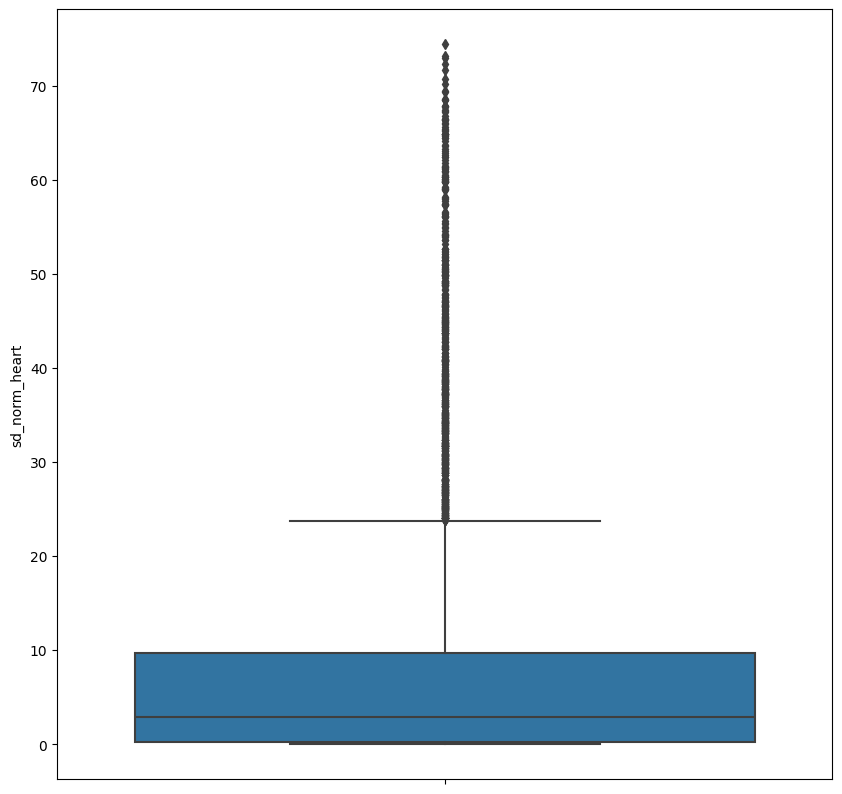

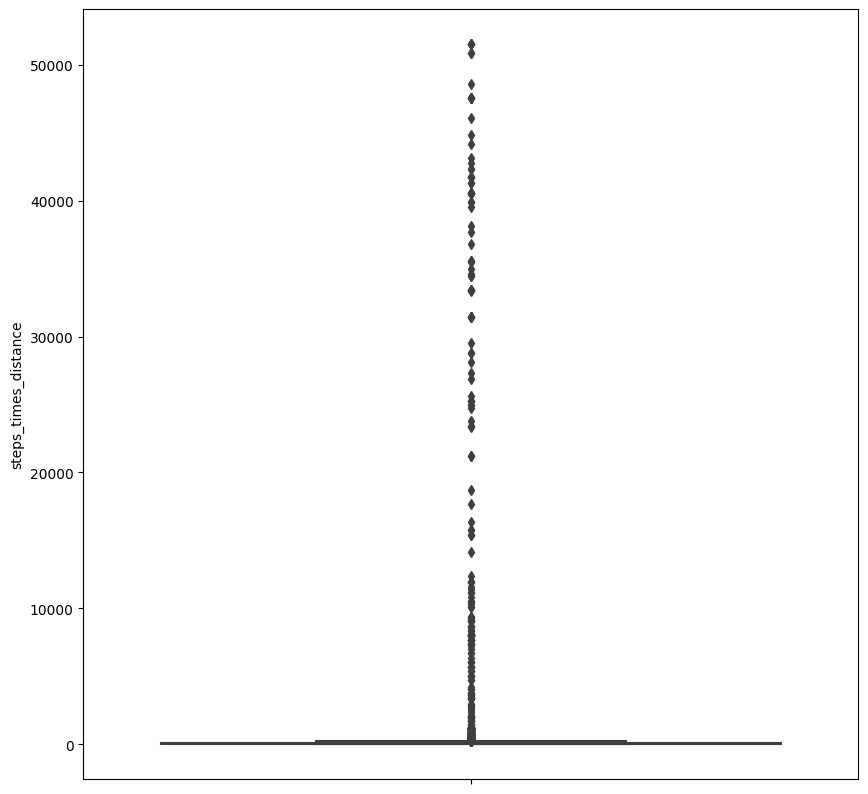

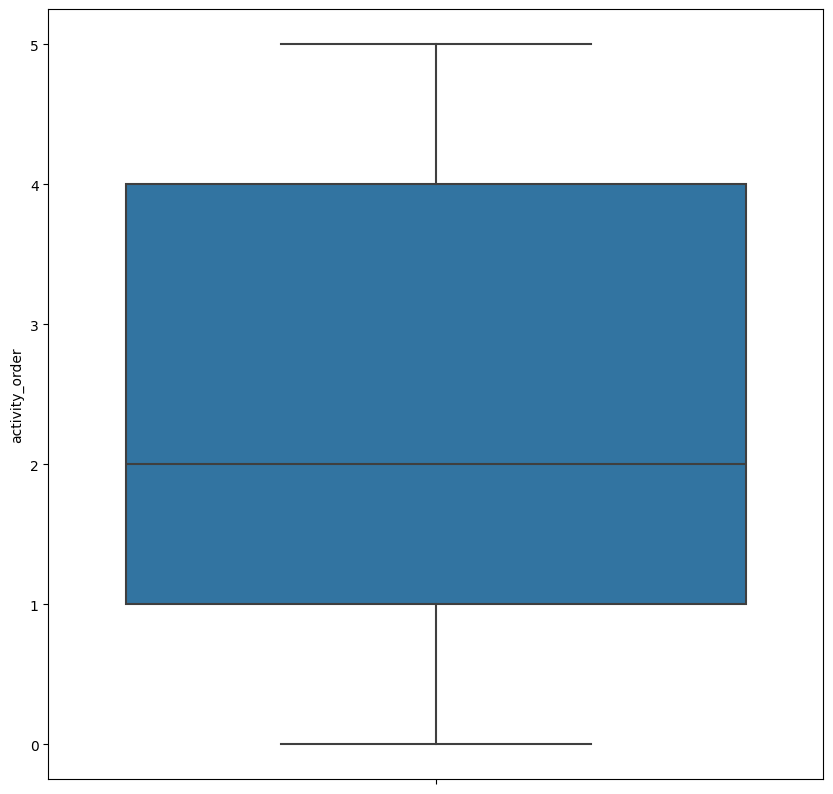

In [10]:
int_cols = data.select_dtypes(exclude='bool').columns
for _ in int_cols:
    plt.figure(figsize=(10,10))
    sns.boxplot(data=data, y= _)
    plt.show()

In [11]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6264 entries, 1 to 6264
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   age                   6264 non-null   int64  
 1   gender                6264 non-null   int64  
 2   height                6264 non-null   float64
 3   weight                6264 non-null   float64
 4   steps                 6264 non-null   float64
 5   hear_rate             6264 non-null   float64
 6   calories              6264 non-null   float64
 7   distance              6264 non-null   float64
 8   entropy_heart         6264 non-null   float64
 9   entropy_setps         6264 non-null   float64
 10  resting_heart         6264 non-null   float64
 11  corr_heart_steps      6264 non-null   float64
 12  norm_heart            6264 non-null   float64
 13  intensity_karvonen    6264 non-null   float64
 14  sd_norm_heart         6264 non-null   float64
 15  steps_times_distance  6264

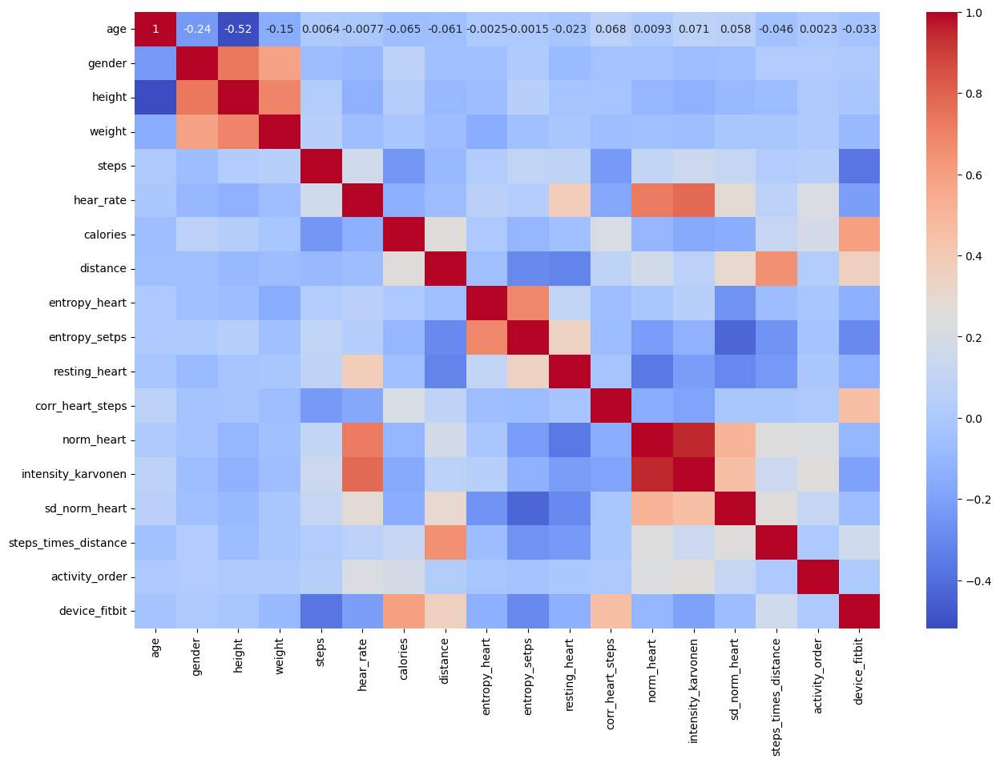

In [12]:
fig = plt.figure(figsize=(15,10))
sns.heatmap(data.corr(), annot=True, cmap='coolwarm')
plt.show()

## Escalar datos

In [13]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

In [14]:
data_scaled = pd.DataFrame(data_scaled, columns=data.columns)

In [15]:
data_scaled

,age,gender,height,weight,steps,hear_rate,calories,distance,entropy_heart,entropy_setps,resting_heart,corr_heart_steps,norm_heart,intensity_karvonen,sd_norm_heart,steps_times_distance,activity_order,device_fitbit
0,-1.028093,1.048090,-0.165544,-0.313324,-0.443445,-0.265692,-0.700439,-0.300934,0.249894,0.299594,-0.324033,0.894497,-0.026108,-0.080412,-0.567322,-0.145181,-1.340804,-0.844599
1,-1.028093,1.048090,-0.165544,-0.313324,-0.440286,-0.268411,-0.592663,-0.300921,0.249894,0.299594,-0.324033,0.894497,-0.028853,-0.083032,-0.567322,-0.145178,-1.340804,-0.844599
2,-1.028093,1.048090,-0.165544,-0.313324,-0.437126,-0.265359,-0.365753,-0.300909,0.249894,0.299594,-0.324033,0.894497,-0.025772,-0.080092,-0.567322,-0.145175,-1.340804,-0.844599
3,-1.028093,1.048090,-0.165544,-0.313324,-0.433967,-0.262307,-0.341197,-0.300897,0.249894,0.299594,-0.324033,0.894497,-0.022692,-0.077151,-0.567322,-0.145171,-1.340804,-0.844599
4,-1.028093,1.048090,-0.165544,-0.313324,-0.430807,-0.259255,-0.316641,-0.300884,0.249894,0.299594,-0.324033,0.872334,-0.019612,-0.074211,-0.627831,-0.145168,-1.340804,-0.844599
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6259,1.890545,-0.954117,-1.182604,0.132746,-0.487307,-1.785316,0.037652,-0.279346,-7.877479,-4.569150,-1.456038,0.894497,-0.714172,-0.737185,-0.647104,-0.144957,1.433640,1.183993
6260,1.890545,-0.954117,-1.182604,0.132746,-0.487307,-1.785316,0.037652,-0.279346,-7.877479,-4.569150,-1.456038,0.894497,-0.714172,-0.737185,-0.567322,-0.144957,1.433640,1.183993
6261,1.890545,-0.954117,-1.182604,0.132746,-0.487307,-1.785316,0.037652,-0.279346,-7.877479,-4.569150,-1.456038,0.894497,-0.714172,-0.737185,-0.567322,-0.144957,1.433640,1.183993
6262,1.890545,-0.954117,-1.182604,0.132746,-0.487307,-1.785316,0.037652,-0.279346,-7.877479,-4.569150,-1.456038,0.894497,-0.714172,-0.737185,-0.567322,-0.144957,1.433640,1.183993


## PCA

In [16]:
from sklearn.decomposition import PCA

In [17]:
pca = PCA()
pca.fit(data_scaled)
pca_data_scaled = pca.transform(data_scaled)
pca_data_scaled

array([[-8.07196778e-01, -3.99170260e-01,  4.15889981e-01, ...,
        -7.12534429e-01,  8.66089273e-02, -9.97216457e-16],
       [-8.20617930e-01, -3.64675228e-01,  4.08201136e-01, ...,
        -7.09627553e-01,  8.89291225e-02, -8.90376343e-16],
       [-8.37627047e-01, -2.94644050e-01,  3.94015167e-01, ...,
        -7.03119969e-01,  9.33157253e-02, -8.80867077e-16],
       ...,
       [ 4.72289364e-01,  5.06796923e+00, -8.98675486e-01, ...,
        -1.54024595e-01,  2.30146578e-01, -1.69630211e-16],
       [ 4.72289364e-01,  5.06796923e+00, -8.98675486e-01, ...,
        -1.54024595e-01,  2.30146578e-01, -1.69630211e-16],
       [ 4.72289364e-01,  5.06796923e+00, -8.98675486e-01, ...,
        -1.54024595e-01,  2.30146578e-01, -1.69630211e-16]])

In [18]:
var = pca.explained_variance_ratio_
print(var)

[1.90951704e-01 1.60295418e-01 1.40253168e-01 8.86157274e-02
 7.59423503e-02 5.97562414e-02 5.24250185e-02 4.78626388e-02
 4.40754821e-02 3.62527911e-02 2.72105865e-02 2.18576613e-02
 1.79184545e-02 1.45260184e-02 1.22855928e-02 7.57835920e-03
 2.19278724e-03 3.08345876e-18]


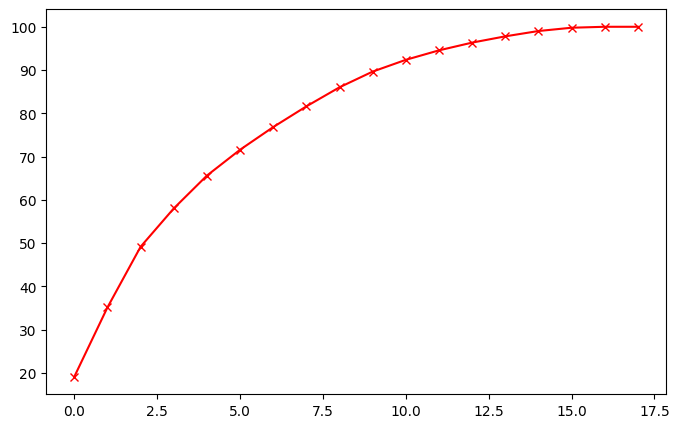

In [19]:
# Versión simple

cum_var = np.cumsum(np.round(var, decimals=4)*100)
plt.figure(figsize=(8,5))
plt.plot(cum_var, 'r-x')
plt.show()

Text(0, 0.5, '% Variance')

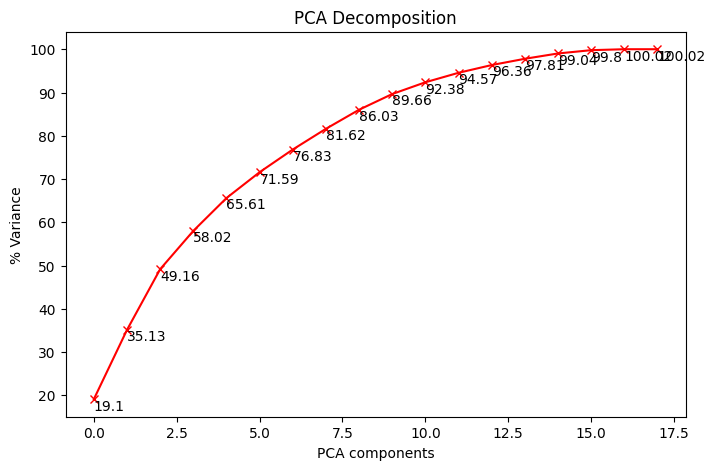

In [20]:
# Version con Anotaciones

cum_var = np.cumsum(np.round(var, decimals=4)*100)
components = list(range(0,18))
plt.figure(figsize=(8,5))
for s,d in zip(components,cum_var):
    plt.annotate(np.round(d,decimals=2), xy=(s,d-2.5))

plt.plot(components,cum_var, 'r-x')
plt.title("PCA Decomposition")
plt.xlabel('PCA components')
plt.ylabel('% Variance')

Con 10 componentes (Columnas) cubro el 90% de la varianza

In [21]:
pca_data_standard = pd.DataFrame(pca_data_scaled)
pca_data_standard.drop(pca_data_standard.columns[11:],axis=1, inplace=True)

In [22]:
pca_data_standard

,0,1,2,3,4,5,6,7,8,9,10
0,-0.807197,-0.399170,0.415890,-0.280437,0.589261,-0.708226,-1.571108,-0.211404,0.555711,-0.187041,-0.667012
1,-0.820618,-0.364675,0.408201,-0.236631,0.580108,-0.696352,-1.541821,-0.221583,0.536806,-0.140559,-0.634087
2,-0.837627,-0.294644,0.394015,-0.138065,0.557541,-0.673519,-1.485423,-0.242596,0.494270,-0.041748,-0.567134
3,-0.835552,-0.288763,0.393448,-0.126266,0.554749,-0.670437,-1.479397,-0.244358,0.490676,-0.028543,-0.560779
4,-0.853464,-0.295820,0.391273,-0.105382,0.560423,-0.661814,-1.466710,-0.258575,0.456905,-0.000220,-0.596105
...,...,...,...,...,...,...,...,...,...,...,...
6259,0.442823,5.057958,-0.905011,-5.353775,-5.234843,0.979561,1.898102,-0.660393,-1.278777,-0.023202,-2.803581
6260,0.472289,5.067969,-0.898675,-5.370200,-5.238140,0.976837,1.895043,-0.654474,-1.259076,-0.040058,-2.742353
6261,0.472289,5.067969,-0.898675,-5.370200,-5.238140,0.976837,1.895043,-0.654474,-1.259076,-0.040058,-2.742353
6262,0.472289,5.067969,-0.898675,-5.370200,-5.238140,0.976837,1.895043,-0.654474,-1.259076,-0.040058,-2.742353


## Importar librerías para clustering

In [23]:
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import dendrogram, linkage

## K-means

### PCA

In [24]:
Sum_of_squared_distances = []
silhouette_scores = []
K = range(2,15)
for _ in K:
    km = KMeans(n_clusters = _)
    y = km.fit_predict(pca_data_standard)
    Sum_of_squared_distances.append(km.inertia_)
    silhouette_scores.append(silhouette_score(pca_data_standard,y))

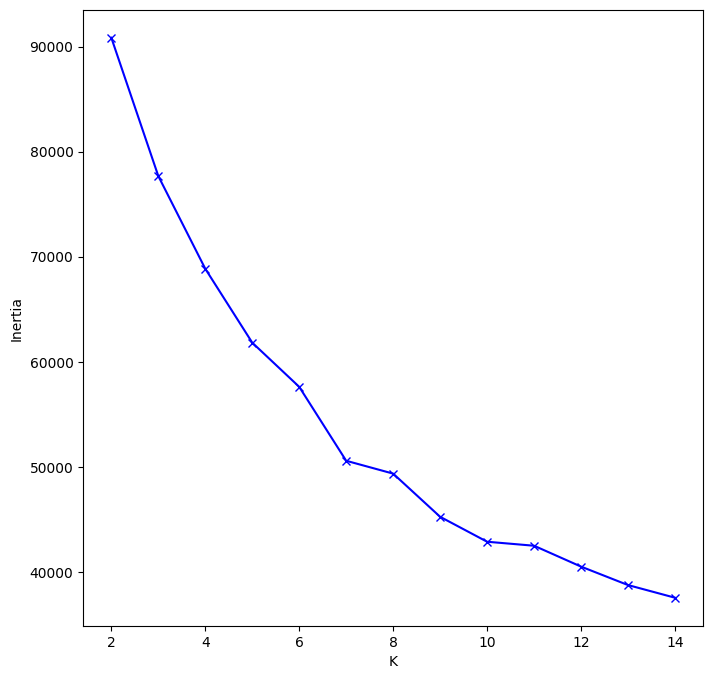

In [25]:
fig = plt.figure(figsize=(8,8))
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('K')
plt.ylabel('Inertia')
plt.show()

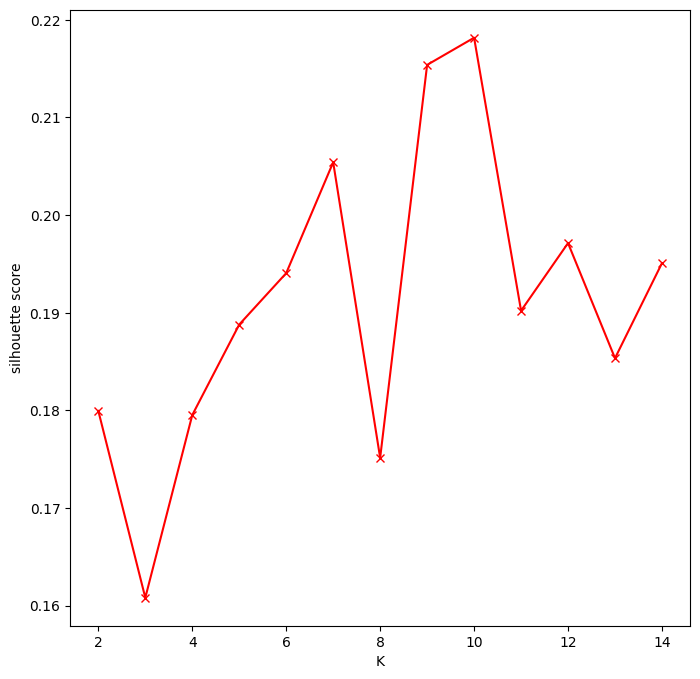

In [26]:
fig = plt.figure(figsize=(8,8))
plt.plot(K, silhouette_scores, 'rx-')
plt.xlabel('K')
plt.ylabel('silhouette score')
plt.show()

In [27]:
km = KMeans(n_clusters = 4)
y = km.fit_predict(pca_data_standard)
print(silhouette_score(pca_data_standard, y))
data['k_means_pca'] = y

0.17671064791731067


### Sin PCA

In [28]:
Sum_of_squared_distances = []
silhouette_scores = []
K = range(2,15)
for _ in K:
    km = KMeans(n_clusters = _)
    y = km.fit_predict(data_scaled)
    Sum_of_squared_distances.append(km.inertia_)
    silhouette_scores.append(silhouette_score(data_scaled,y))

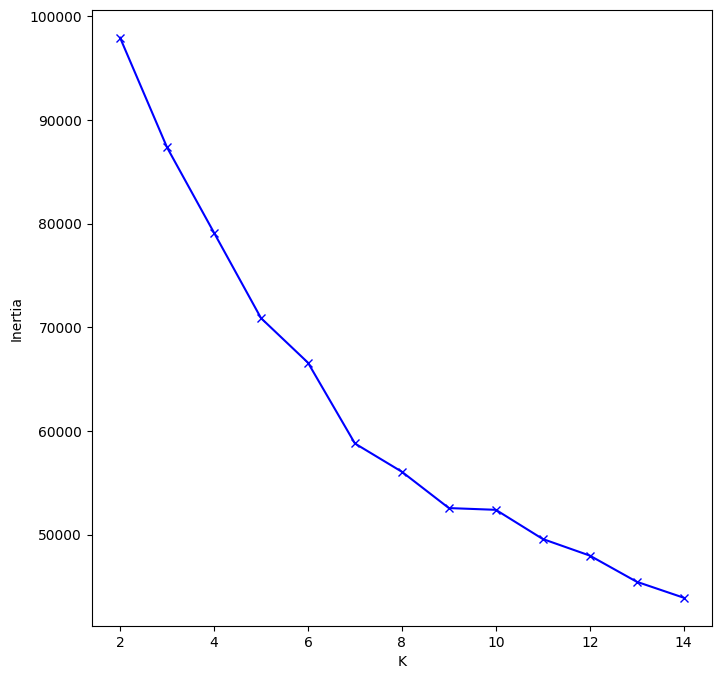

In [29]:
fig = plt.figure(figsize=(8,8))
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('K')
plt.ylabel('Inertia')
plt.show()

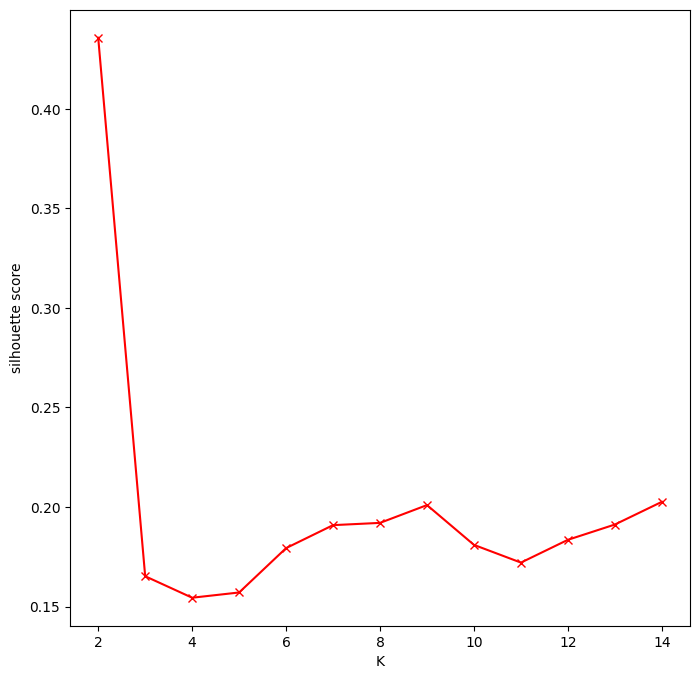

In [30]:
fig = plt.figure(figsize=(8,8))
plt.plot(K, silhouette_scores, 'rx-')
plt.xlabel('K')
plt.ylabel('silhouette score')
plt.show()

In [31]:
km = KMeans(n_clusters = 6)
y = km.fit_predict(data_scaled)
print(silhouette_score(data_scaled, y))
data['k_means'] = y

0.1789532743201952


/Users/cosmos/Adri/Developer/DataScience/Clases + Consignas/Repo compartido Equipo 3/bootcamp-ds-mlops/env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/cosmos/Adri/Developer/DataScience/Clases + Consignas/Repo compartido Equipo 3/bootcamp-ds-mlops/env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/cosmos/Adri/Developer/DataScience/Clases + Consignas/Repo compartido Equipo 3/bootcamp-ds-mlops/env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN bef

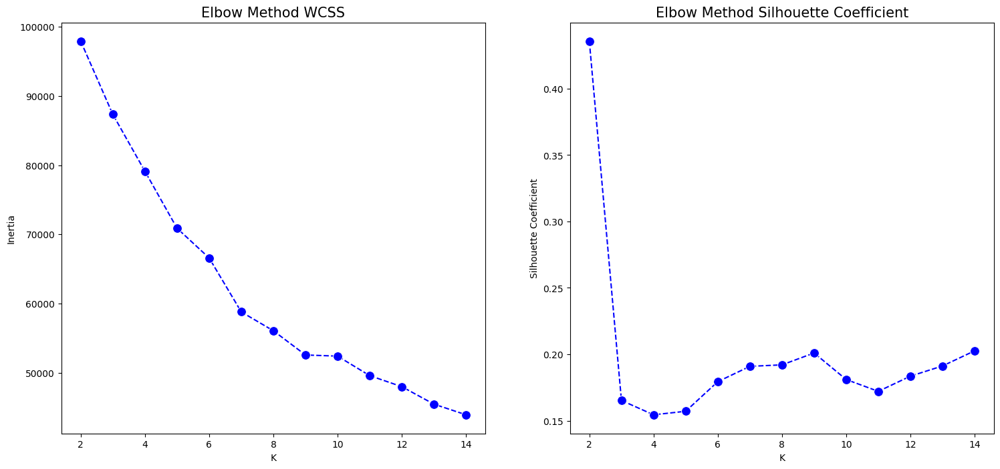

In [32]:
figdata = [
    (Sum_of_squared_distances, 'Elbow Method WCSS'),
    (silhouette_scores, 'Elbow Method Silhouette Coefficient')
]

fig, axes = plt.subplots(1, 2, figsize=(18, 8))

for i, (values, title) in enumerate(figdata):
    sns.lineplot(ax=axes[i], x=K, y=values, linestyle='dashed', marker='o', markersize=10, color='b')
    axes[i].set_xlabel('K')
    axes[i].set_ylabel('Inertia' if i == 0 else 'Silhouette Coefficient')
    axes[i].set_title(title, size=15)

Sin PCA y con 6 clusters logramos el mismo silhouette (0,18) score que con PCA y 4 clústers

## Agglomerativen hierarchical clustering

### PCA

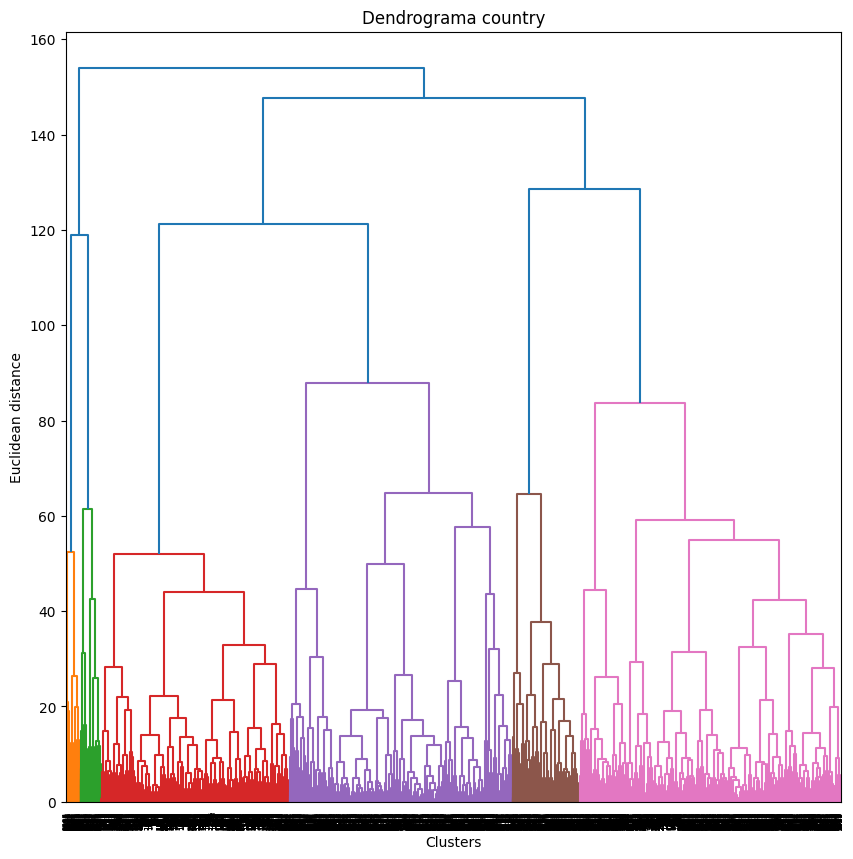

In [33]:
fig = plt.figure(figsize=(10,10))
dendrogram_plot = dendrogram(linkage(pca_data_standard, method='ward'))
plt.title('Dendrograma country')
plt.xlabel('Clusters')
plt.ylabel('Euclidean distance')
plt.show()

In [34]:
hc = AgglomerativeClustering(n_clusters=4, metric='euclidean', linkage='ward')
y_hc = hc.fit_predict(pca_data_standard)
print(silhouette_score(pca_data_standard,y_hc ))
data['hc_pca'] = y_hc

0.15258367520193444


### Sin PCA

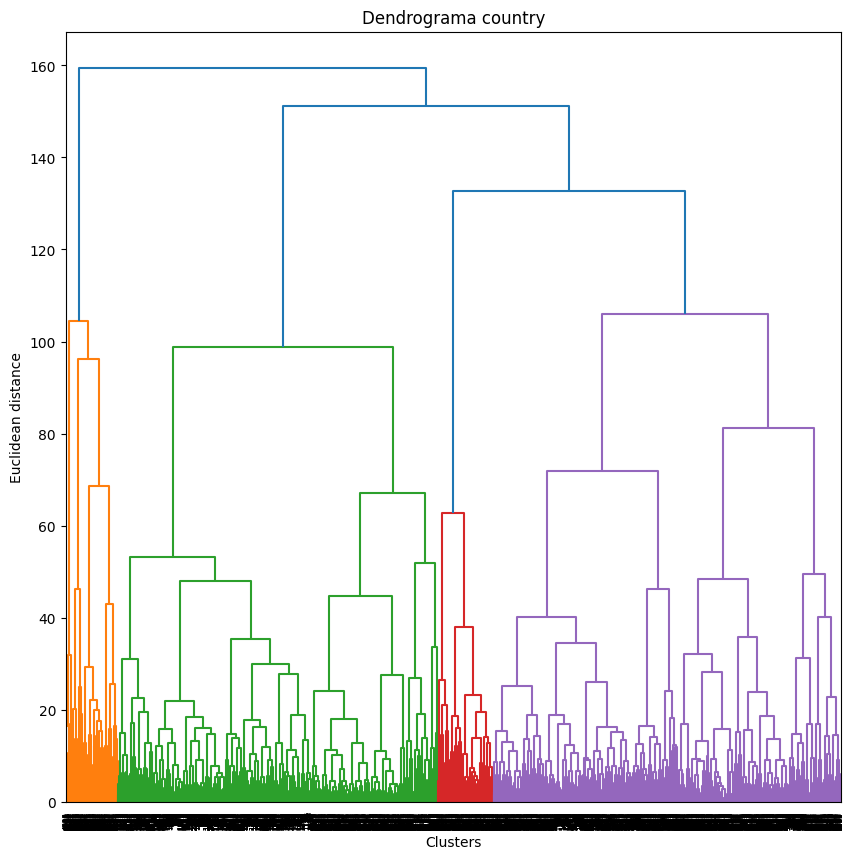

In [35]:
fig = plt.figure(figsize=(10,10))
dendrogram_plot = dendrogram(linkage(data_scaled, method='ward'))
plt.title('Dendrograma country')
plt.xlabel('Clusters')
plt.ylabel('Euclidean distance')
plt.show()

In [36]:
hc = AgglomerativeClustering(n_clusters=4, metric='euclidean', linkage='ward')
y_hc = hc.fit_predict(data_scaled)
print(silhouette_score(data_scaled,y_hc ))
data['hc'] = y_hc

0.15842173401667495


Sin PCA el silhouette score con AgglomerativeClustering y 4 clusters es significativamente menor (0.08) que con PCA y el mismo método (0.15)

## DBSCAN

### PCA

In [37]:
from sklearn.neighbors import NearestNeighbors
neighbors = NearestNeighbors(n_neighbors=2)
neighbors_fit = neighbors.fit(pca_data_standard)
distances, indices = neighbors_fit.kneighbors(pca_data_standard)

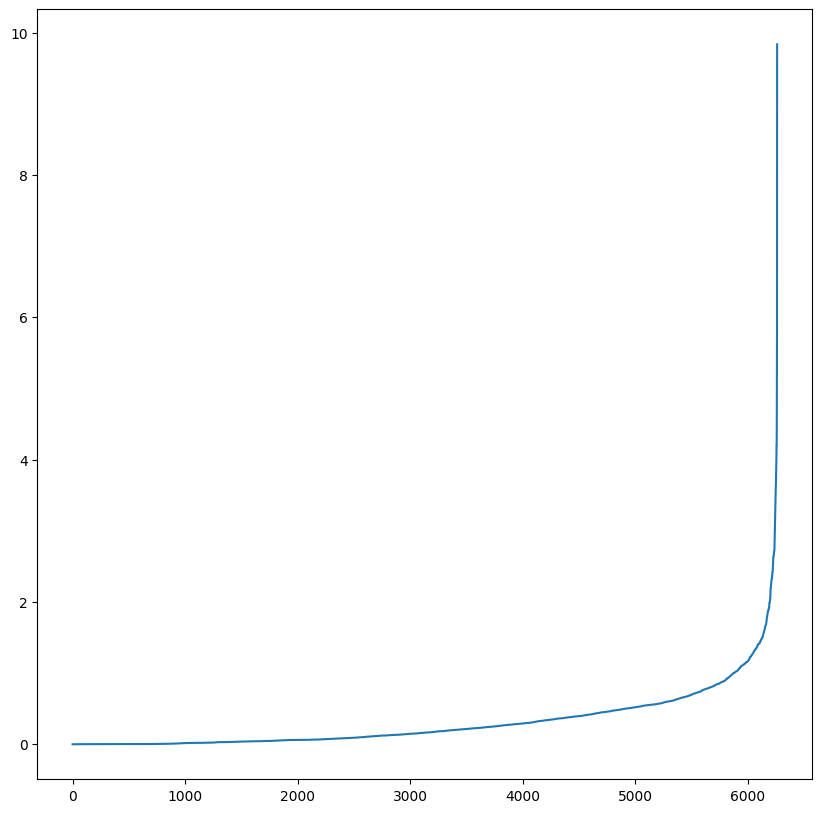

In [38]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]
fig = plt.figure(figsize=(10,10))
plt.plot(distances)

In [39]:
eps_values = np.arange(1.5, 4.0, 0.20)
min_samples = np.arange(20,32)

In [40]:
from itertools import product
dbscan_paramns = list(product(eps_values,min_samples))
no_of_clusters = []
sil_score = []
for p in dbscan_paramns:
    y_dbscan = DBSCAN(eps=p[0], min_samples=p[1]).fit_predict(pca_data_standard)
    try:
        sil_score.append(silhouette_score(pca_data_standard,y_dbscan))
    except:
        sil_score.append(0)
    no_of_clusters.append(len(np.unique(y_dbscan)))


In [41]:
df_param_tunning = pd.DataFrame.from_records(dbscan_paramns, columns=['Eps','Min_samples'])
df_param_tunning['sil_score'] = sil_score
df_param_tunning['n_clusters'] = no_of_clusters

In [42]:
pivot_1 = pd.pivot_table(df_param_tunning, values='sil_score', columns='Eps', index='Min_samples')
pivot_2 = pd.pivot_table(df_param_tunning, values='n_clusters', columns='Eps', index='Min_samples')

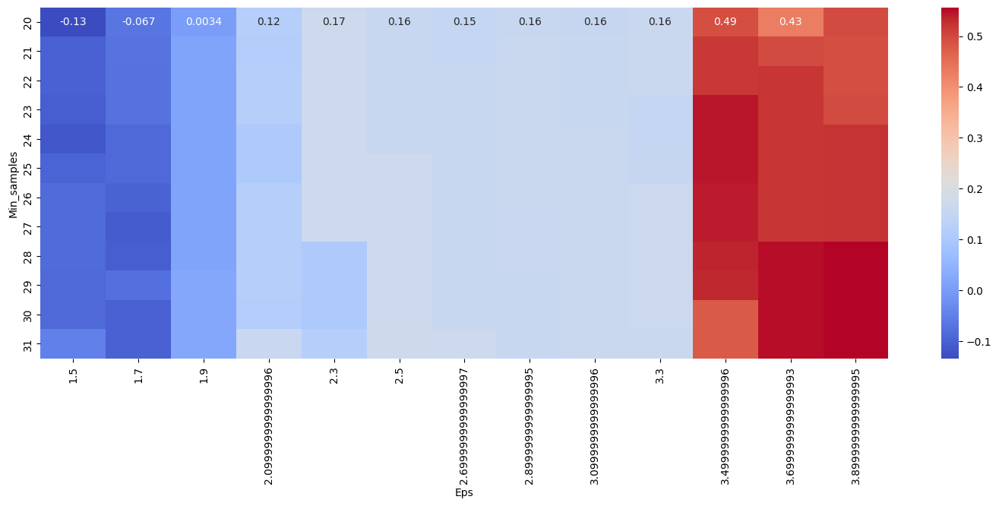

In [43]:
fig, ax = plt.subplots(figsize=(18,6))
sns.heatmap(pivot_1, annot=True, annot_kws={'size':10}, cmap='coolwarm', ax=ax)
plt.show()

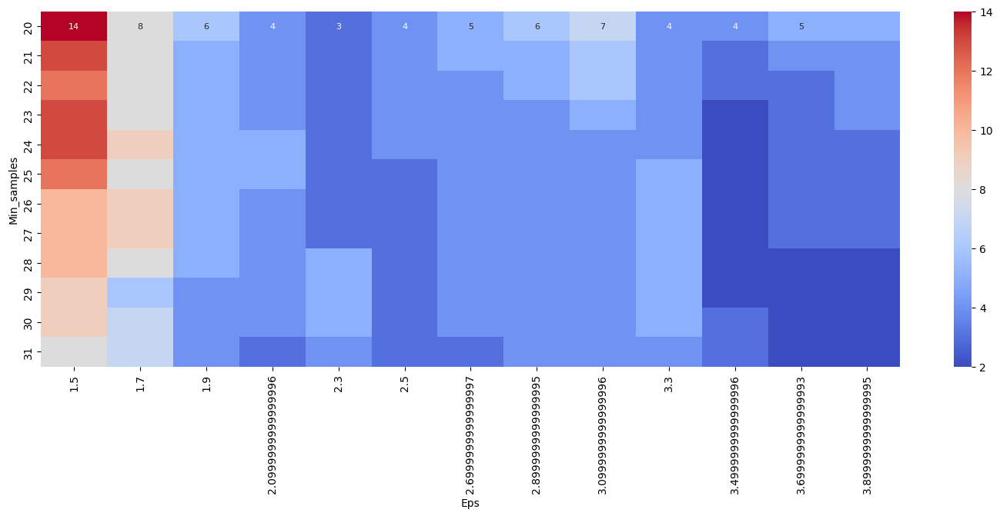

In [44]:
fig, ax = plt.subplots(figsize=(18,6))
sns.heatmap(pivot_2, annot=True, annot_kws={'size':8}, cmap='coolwarm', ax=ax)
plt.show()

In [45]:
dbscan_train = DBSCAN(eps=3.9, min_samples=23)
y_dbscan = dbscan_train.fit_predict(pca_data_standard)
print("k = 4")
print(silhouette_score(pca_data_standard,y_dbscan ))
data['dbscan_pca'] = y_dbscan

k = 4
0.49554522994658257


### Sin PCA

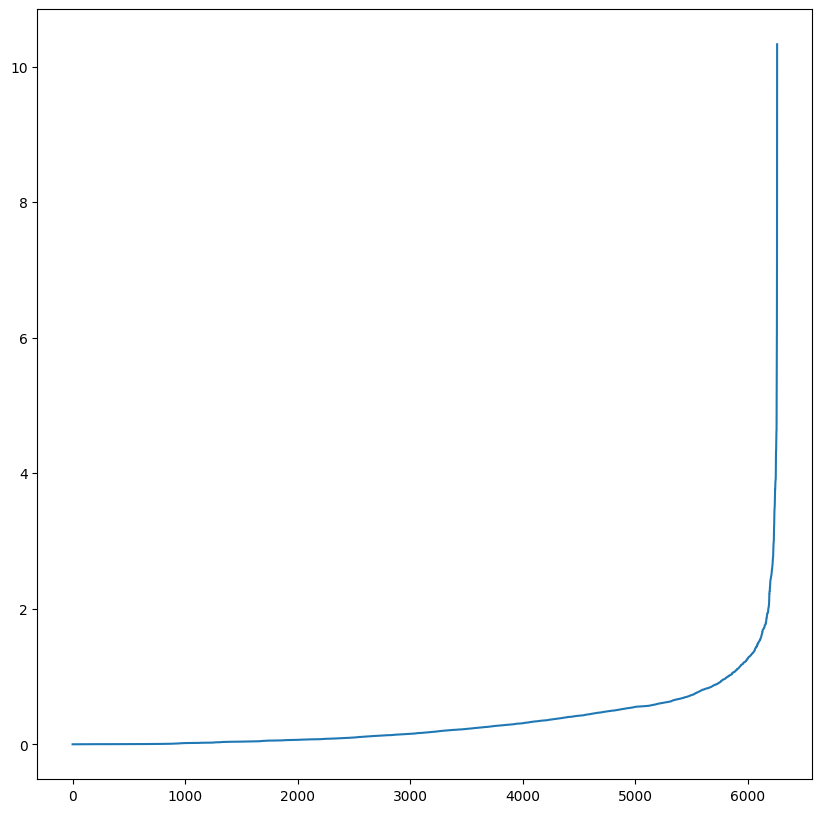

In [46]:
neighbors = NearestNeighbors(n_neighbors=2)
neighbors_fit = neighbors.fit(data_scaled)
distances, indices = neighbors_fit.kneighbors(data_scaled)

distances = np.sort(distances, axis=0)
distances = distances[:,1]
fig = plt.figure(figsize=(10,10))
plt.plot(distances)

In [47]:
eps_values = np.arange(1, 3.0, 0.10)
min_samples = np.arange(20,32)

In [48]:
from itertools import product
dbscan_paramns = list(product(eps_values,min_samples))
no_of_clusters = []
sil_score = []
for p in dbscan_paramns:
    y_dbscan = DBSCAN(eps=p[0], min_samples=p[1]).fit_predict(data_scaled)
    try:
        sil_score.append(silhouette_score(data_scaled,y_dbscan))
    except:
        sil_score.append(0)
    no_of_clusters.append(len(np.unique(y_dbscan)))

In [49]:
df_param_tunning = pd.DataFrame.from_records(dbscan_paramns, columns=['Eps','Min_samples'])
df_param_tunning['sil_score'] = sil_score
df_param_tunning['n_clusters'] = no_of_clusters

In [50]:
pivot_1 = pd.pivot_table(df_param_tunning, values='sil_score', columns='Eps', index='Min_samples')
pivot_2 = pd.pivot_table(df_param_tunning, values='n_clusters', columns='Eps', index='Min_samples')

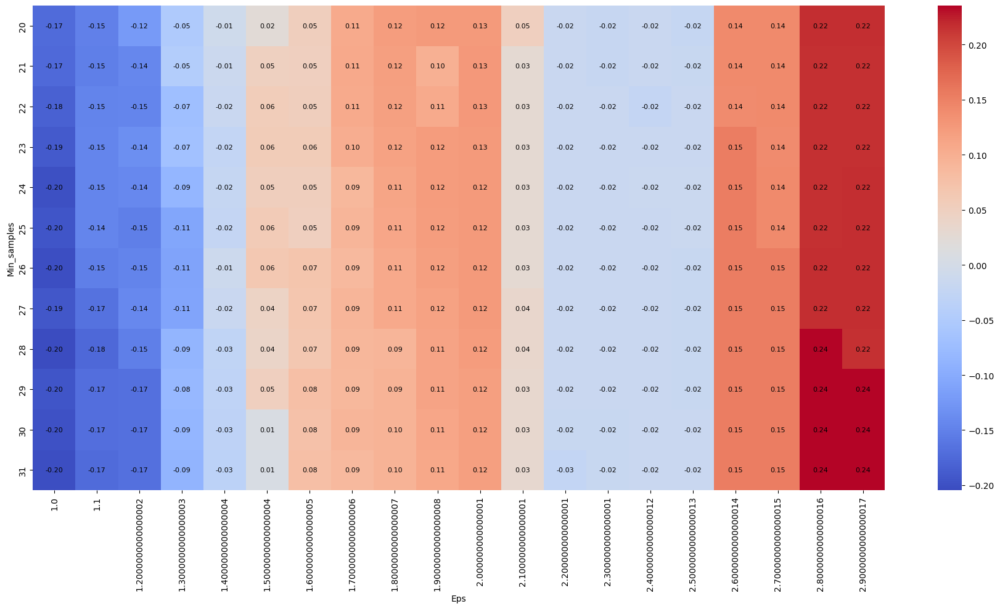

In [79]:
fig, ax = plt.subplots(figsize=(18,10))
sns.heatmap(pivot_1, cmap='coolwarm', ax=ax)
# Dibujar manualmente cada anotación pues sin esto solo muestra valores en la primer fila
for i in range(pivot_1.shape[0]):
    for j in range(pivot_1.shape[1]):
        text = f"{pivot_1.iloc[i, j]:.2f}"
        ax.text(j + 0.5, i + 0.5, text,
                ha="center", va="center",
                fontsize=8, color="black")
plt.tight_layout()
plt.show()

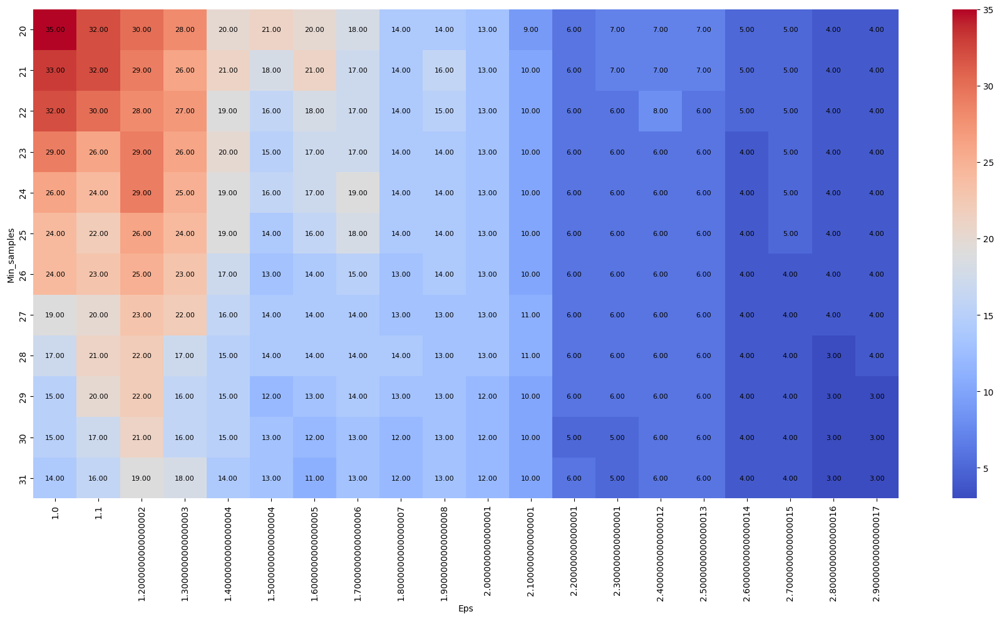

In [78]:
fig, ax = plt.subplots(figsize=(18,10))
sns.heatmap(pivot_2, cmap='coolwarm', ax=ax)
# Dibujar manualmente cada anotación pues sin esto solo muestra valores en la primer fila
for i in range(pivot_2.shape[0]):
    for j in range(pivot_2.shape[1]):
        text = f"{pivot_2.iloc[i, j]:.2f}"
        ax.text(j + 0.5, i + 0.5, text,
                ha="center", va="center",
                fontsize=8, color="black")
plt.tight_layout()
plt.show()

In [53]:
dbscan_train = DBSCAN(eps=2.9, min_samples=31)
y_dbscan = dbscan_train.fit_predict(data_scaled)
print("k = 3, sin PCA:")
print(silhouette_score(data_scaled,y_dbscan ))
data['dbscan_cluster'] = y_dbscan

k = 3, sin PCA:
0.2351297386821595


In [54]:
data

,age,gender,height,weight,steps,hear_rate,calories,distance,entropy_heart,entropy_setps,...,sd_norm_heart,steps_times_distance,activity_order,device_fitbit,k_means_pca,k_means,hc_pca,hc,dbscan_pca,dbscan_cluster
1,20,1,168.0,65.4,10.771429,78.531302,0.344533,0.008327,6.221612,6.116349,...,1.000000,0.089692,0,False,2,5,0,2,0,0
2,20,1,168.0,65.4,11.475325,78.453390,3.287625,0.008896,6.221612,6.116349,...,1.000000,0.102088,0,False,2,5,0,2,0,0
3,20,1,168.0,65.4,12.179221,78.540825,9.484000,0.009466,6.221612,6.116349,...,1.000000,0.115287,0,False,2,5,0,2,0,0
4,20,1,168.0,65.4,12.883117,78.628260,10.154556,0.010035,6.221612,6.116349,...,1.000000,0.129286,0,False,2,5,0,2,0,0
5,20,1,168.0,65.4,13.587013,78.715695,10.825111,0.010605,6.221612,6.116349,...,0.241567,0.144088,0,False,2,5,0,2,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6260,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,...,0.000000,1.000000,5,True,0,1,1,1,-1,-1
6261,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,...,1.000000,1.000000,5,True,0,1,1,1,-1,-1
6262,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,...,1.000000,1.000000,5,True,0,1,1,1,-1,-1
6263,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,...,1.000000,1.000000,5,True,0,1,1,1,-1,-1


## Evaluación de resultados

In [55]:
data.columns

Index(['age', 'gender', 'height', 'weight', 'steps', 'hear_rate', 'calories',
       'distance', 'entropy_heart', 'entropy_setps', 'resting_heart',
       'corr_heart_steps', 'norm_heart', 'intensity_karvonen', 'sd_norm_heart',
       'steps_times_distance', 'activity_order', 'device_fitbit',
       'k_means_pca', 'k_means', 'hc_pca', 'hc', 'dbscan_pca',
       'dbscan_cluster'],
      dtype='object')

### KMEANS con PCA: k = 4, Score = 0.18

In [56]:
data[['age', 'gender', 'height', 'weight', 'steps', 'hear_rate', 'calories',
       'distance', 'entropy_heart', 'entropy_setps', 'resting_heart',
       'corr_heart_steps', 'norm_heart', 'intensity_karvonen', 'sd_norm_heart',
       'steps_times_distance', 'k_means_pca']]

,age,gender,height,weight,steps,hear_rate,calories,distance,entropy_heart,entropy_setps,resting_heart,corr_heart_steps,norm_heart,intensity_karvonen,sd_norm_heart,steps_times_distance,k_means_pca
1,20,1,168.0,65.4,10.771429,78.531302,0.344533,0.008327,6.221612,6.116349,59.0,1.000000,19.531302,0.138520,1.000000,0.089692,2
2,20,1,168.0,65.4,11.475325,78.453390,3.287625,0.008896,6.221612,6.116349,59.0,1.000000,19.453390,0.137967,1.000000,0.102088,2
3,20,1,168.0,65.4,12.179221,78.540825,9.484000,0.009466,6.221612,6.116349,59.0,1.000000,19.540825,0.138587,1.000000,0.115287,2
4,20,1,168.0,65.4,12.883117,78.628260,10.154556,0.010035,6.221612,6.116349,59.0,1.000000,19.628260,0.139208,1.000000,0.129286,2
5,20,1,168.0,65.4,13.587013,78.715695,10.825111,0.010605,6.221612,6.116349,59.0,0.982816,19.715695,0.139828,0.241567,0.144088,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6260,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,35.0,1.000000,0.000000,0.000000,0.000000,1.000000,0
6261,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,35.0,1.000000,0.000000,0.000000,1.000000,1.000000,0
6262,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,35.0,1.000000,0.000000,0.000000,1.000000,1.000000,0
6263,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,35.0,1.000000,0.000000,0.000000,1.000000,1.000000,0


/Users/cosmos/Adri/Developer/DataScience/Clases + Consignas/Repo compartido Equipo 3/bootcamp-ds-mlops/env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/cosmos/Adri/Developer/DataScience/Clases + Consignas/Repo compartido Equipo 3/bootcamp-ds-mlops/env/lib/python3.11/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/cosmos/Adri/Developer/DataScience/Clases + Consignas/Repo compartido Equipo 3/bootcamp-ds-mlops/env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

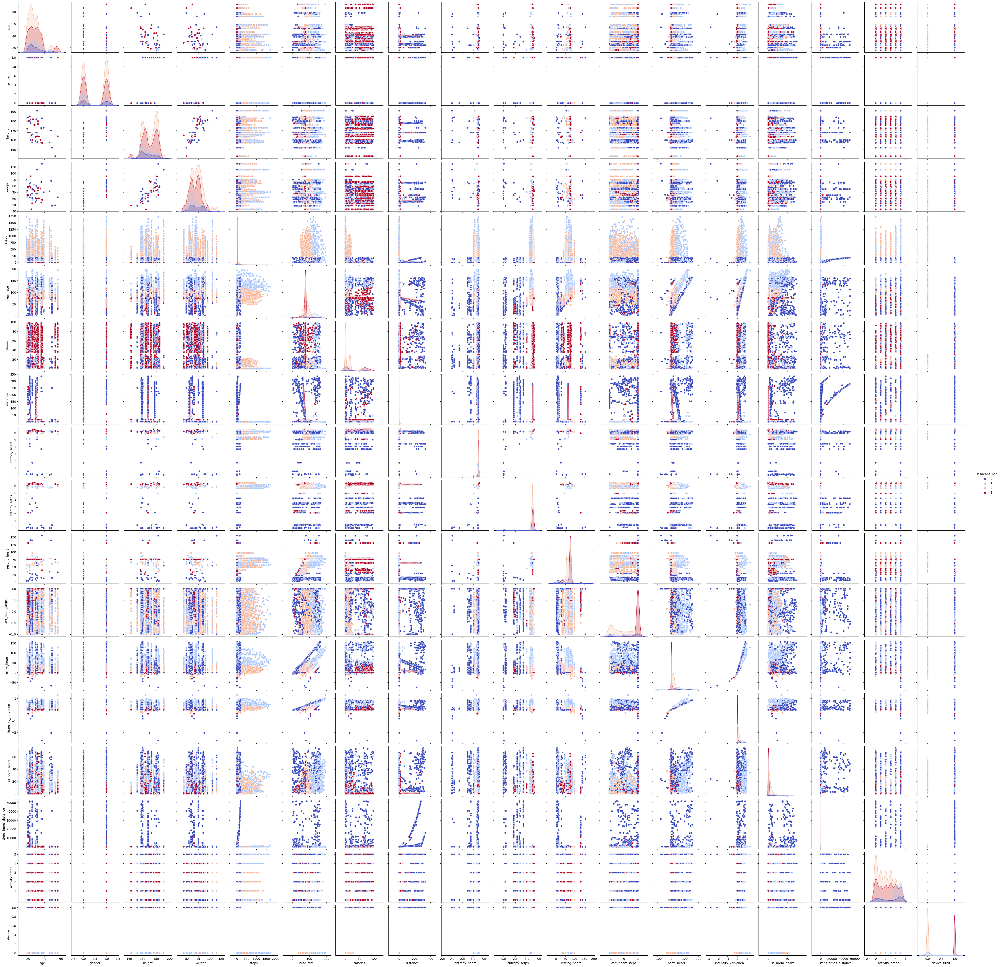

In [57]:
sns.pairplot(data = data[['age', 'gender', 'height', 'weight', 'steps', 'hear_rate', 'calories',
       'distance', 'entropy_heart', 'entropy_setps', 'resting_heart',
       'corr_heart_steps', 'norm_heart', 'intensity_karvonen', 'sd_norm_heart',
       'steps_times_distance', 'activity_order', 'device_fitbit', 'k_means_pca']], hue='k_means_pca', palette='coolwarm')

In [58]:
data

,age,gender,height,weight,steps,hear_rate,calories,distance,entropy_heart,entropy_setps,...,sd_norm_heart,steps_times_distance,activity_order,device_fitbit,k_means_pca,k_means,hc_pca,hc,dbscan_pca,dbscan_cluster
1,20,1,168.0,65.4,10.771429,78.531302,0.344533,0.008327,6.221612,6.116349,...,1.000000,0.089692,0,False,2,5,0,2,0,0
2,20,1,168.0,65.4,11.475325,78.453390,3.287625,0.008896,6.221612,6.116349,...,1.000000,0.102088,0,False,2,5,0,2,0,0
3,20,1,168.0,65.4,12.179221,78.540825,9.484000,0.009466,6.221612,6.116349,...,1.000000,0.115287,0,False,2,5,0,2,0,0
4,20,1,168.0,65.4,12.883117,78.628260,10.154556,0.010035,6.221612,6.116349,...,1.000000,0.129286,0,False,2,5,0,2,0,0
5,20,1,168.0,65.4,13.587013,78.715695,10.825111,0.010605,6.221612,6.116349,...,0.241567,0.144088,0,False,2,5,0,2,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6260,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,...,0.000000,1.000000,5,True,0,1,1,1,-1,-1
6261,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,...,1.000000,1.000000,5,True,0,1,1,1,-1,-1
6262,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,...,1.000000,1.000000,5,True,0,1,1,1,-1,-1
6263,46,0,157.5,71.4,1.000000,35.000000,20.500000,1.000000,0.000000,0.000000,...,1.000000,1.000000,5,True,0,1,1,1,-1,-1


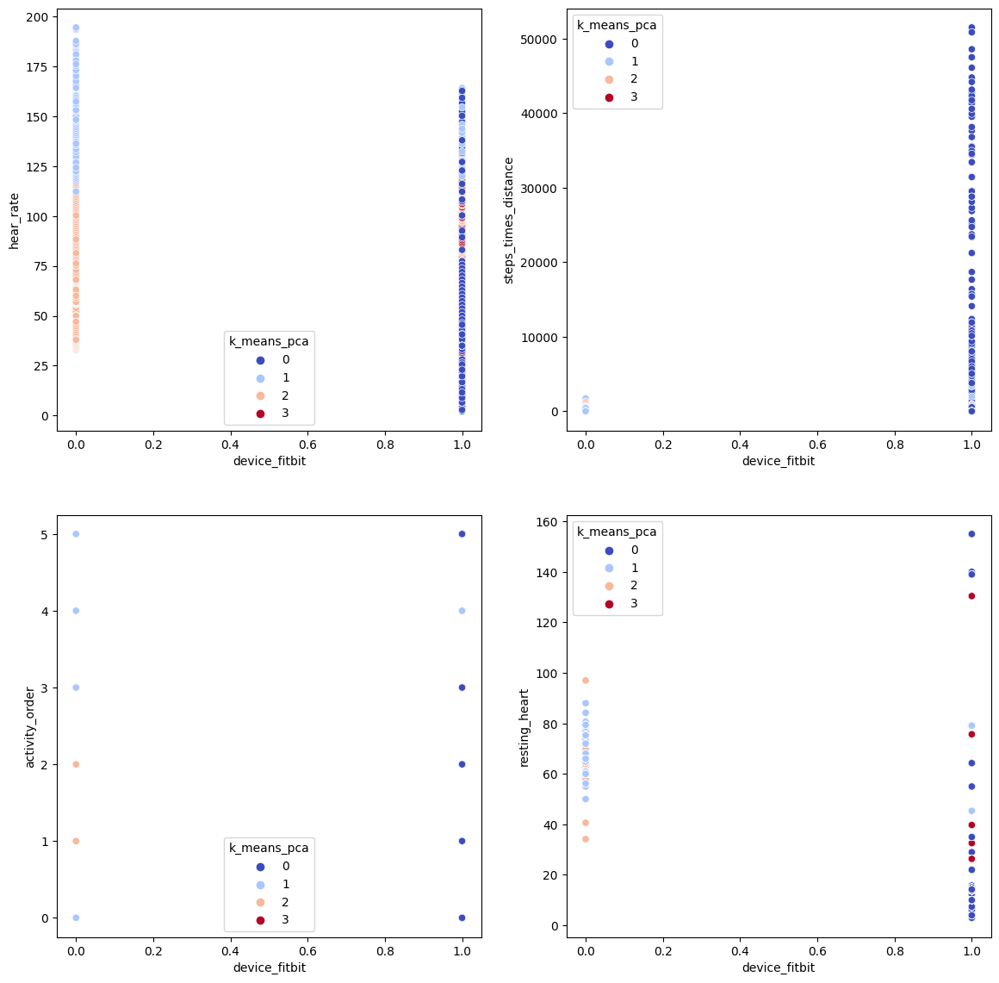

In [59]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(14,14))
ax1 = sns.scatterplot(data=data, x='device_fitbit', y='hear_rate', hue='k_means_pca', palette='coolwarm', ax=ax1)
ax2 = sns.scatterplot(data=data, x='device_fitbit', y='steps_times_distance' ,hue='k_means_pca', palette='coolwarm', ax=ax2)
ax3 = sns.scatterplot(data=data, x='device_fitbit', y='activity_order', hue='k_means_pca', palette='coolwarm', ax=ax3)
ax4 = sns.scatterplot(data=data, x='device_fitbit', y='resting_heart', hue='k_means_pca', palette='coolwarm', ax=ax4)
plt.show()

<Axes: xlabel='device_fitbit', ylabel='activity_order'>

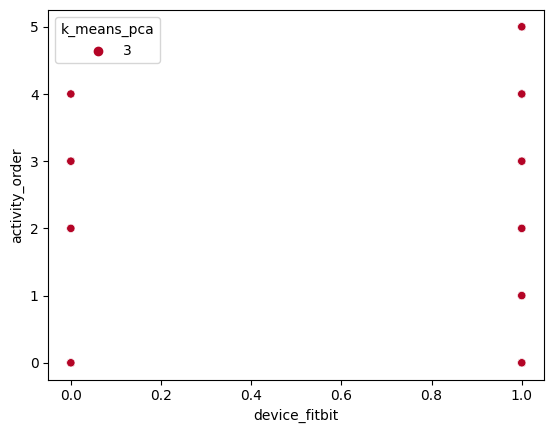

In [60]:
sns.scatterplot(data=data[data['k_means_pca'] == 3], x='device_fitbit', y='activity_order', hue='k_means_pca', palette='coolwarm_r')

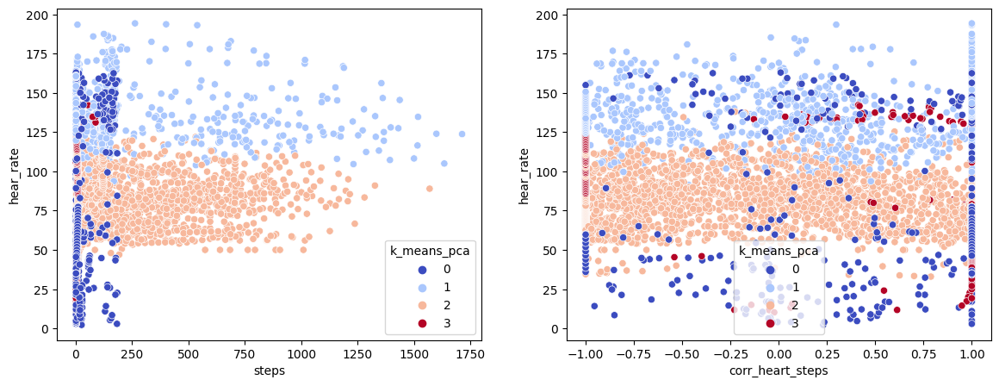

In [61]:

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14,5))
ax1 = sns.scatterplot(data=data, x='steps', y='hear_rate' , hue='k_means_pca', palette='coolwarm', ax=ax1)
ax2 = sns.scatterplot(data=data, x='corr_heart_steps', y='hear_rate' ,hue='k_means_pca', palette='coolwarm', ax=ax2)
plt.show()

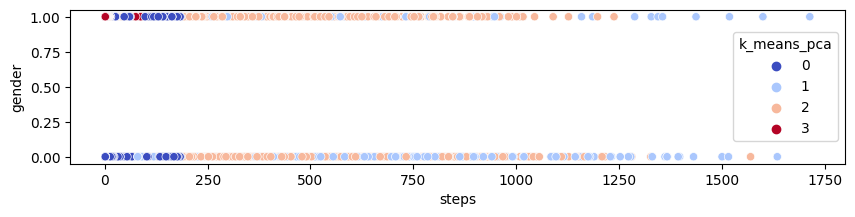

In [62]:
fig = plt.figure(figsize=(10,2))
sns.scatterplot(data=data, x='steps', y='gender',hue='k_means_pca', palette='coolwarm')
plt.show()

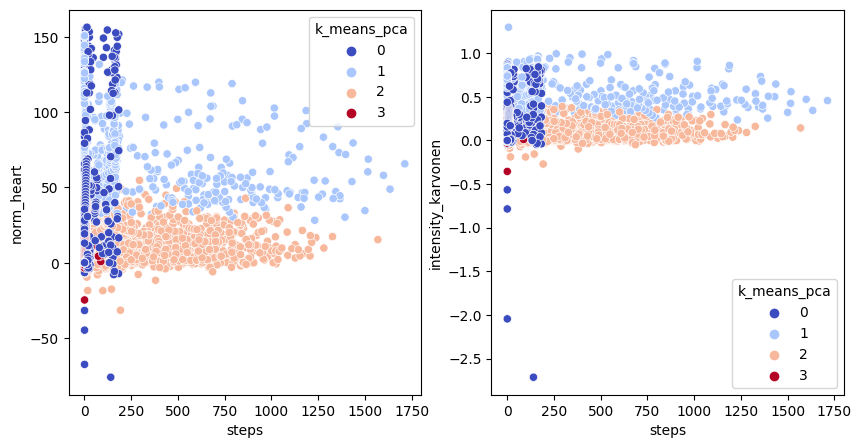

In [63]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,5))
ax1 = sns.scatterplot(data=data, x='steps', y='norm_heart',hue='k_means_pca', palette='coolwarm', ax=ax1)
ax2 = sns.scatterplot(data=data, x='steps', y='intensity_karvonen',hue='k_means_pca', palette='coolwarm', ax=ax2)
plt.show()

Como el cluster 3 no se visualiza bien, filtro el gráfico para ver solo este clúster

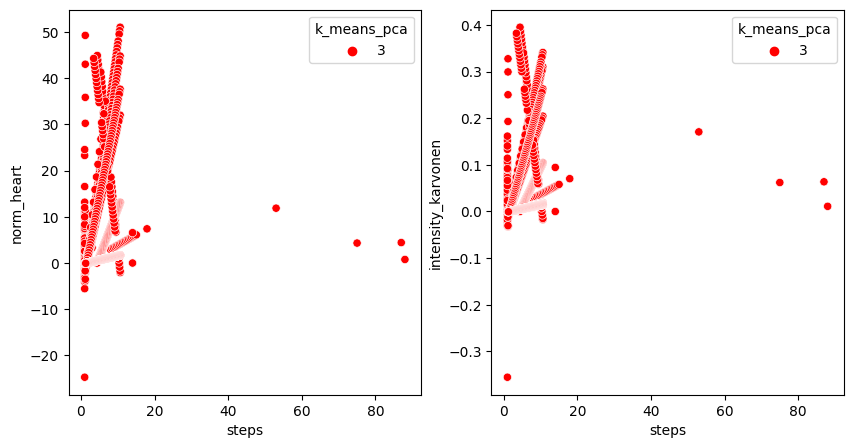

In [64]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,5))
ax1 = sns.scatterplot(data=data[data['k_means_pca'] == 3], x='steps', y='norm_heart',hue='k_means_pca', palette=['red'], ax=ax1)
ax2 = sns.scatterplot(data=data[data['k_means_pca'] == 3], x='steps', y='intensity_karvonen',hue='k_means_pca', palette=['red'], ax=ax2)
plt.show()

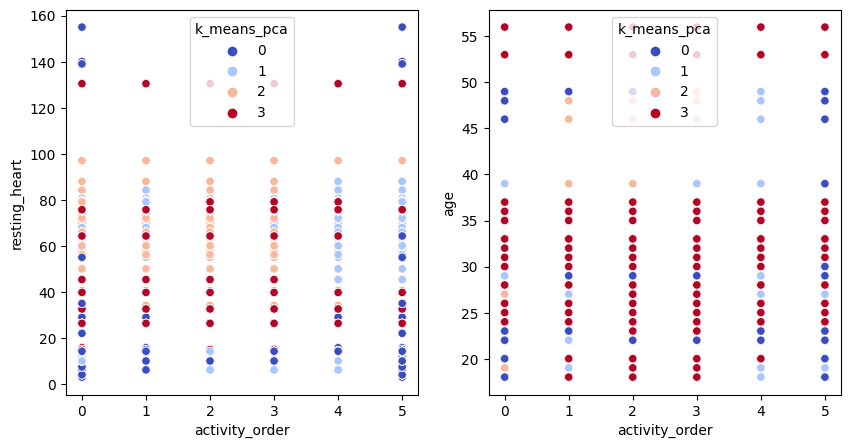

In [65]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,5))
ax1 = sns.scatterplot(data=data, x='activity_order', y='resting_heart',hue='k_means_pca', palette='coolwarm', ax=ax1)
ax2 = sns.scatterplot(data=data, x='activity_order', y='age',hue='k_means_pca', palette='coolwarm', ax=ax2)
plt.show()

### DBSCAN con PCA: k = 4, Score = 0.49

In [66]:
data.columns

Index(['age', 'gender', 'height', 'weight', 'steps', 'hear_rate', 'calories',
       'distance', 'entropy_heart', 'entropy_setps', 'resting_heart',
       'corr_heart_steps', 'norm_heart', 'intensity_karvonen', 'sd_norm_heart',
       'steps_times_distance', 'activity_order', 'device_fitbit',
       'k_means_pca', 'k_means', 'hc_pca', 'hc', 'dbscan_pca',
       'dbscan_cluster'],
      dtype='object')

In [67]:
data['dbscan_pca'].unique()

array([ 0, -1,  1,  2])

In [68]:
data_noiseless = data[data['dbscan_pca'] != -1]

/Users/cosmos/Adri/Developer/DataScience/Clases + Consignas/Repo compartido Equipo 3/bootcamp-ds-mlops/env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/cosmos/Adri/Developer/DataScience/Clases + Consignas/Repo compartido Equipo 3/bootcamp-ds-mlops/env/lib/python3.11/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/cosmos/Adri/Developer/DataScience/Clases + Consignas/Repo compartido Equipo 3/bootcamp-ds-mlops/env/lib/python3.11/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to 

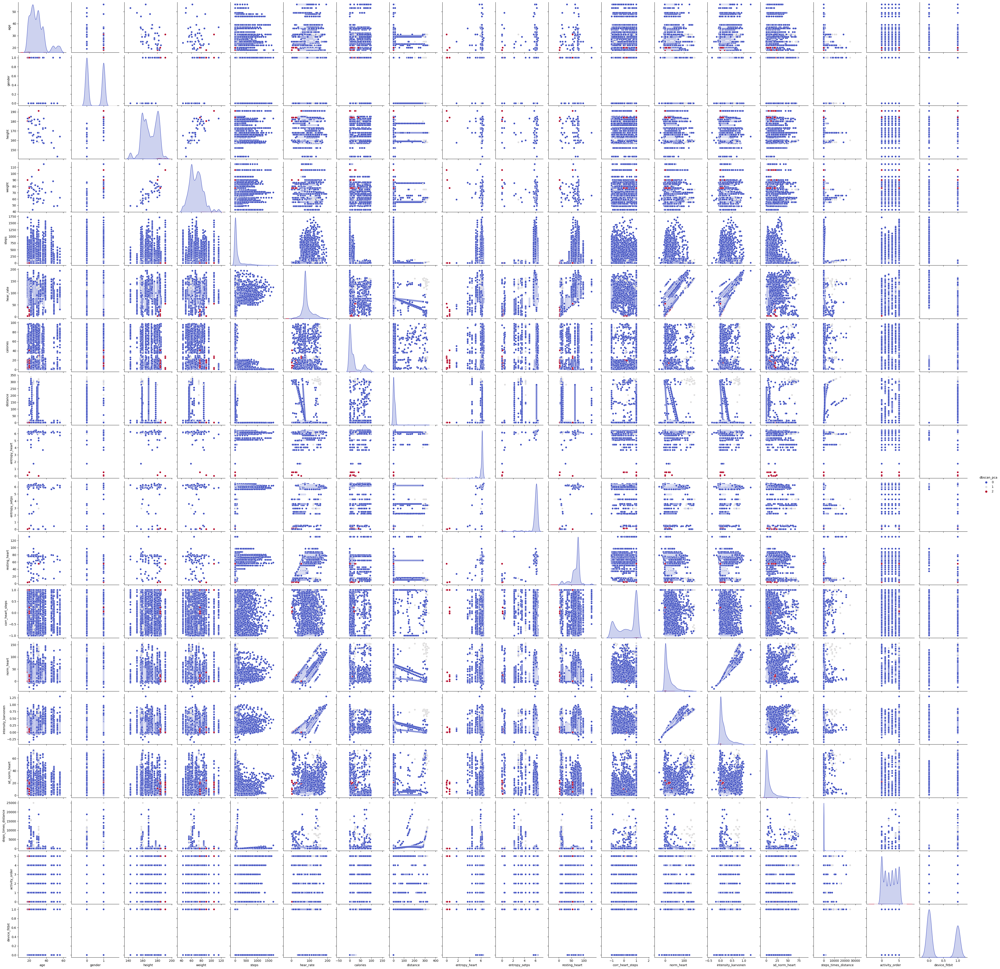

In [69]:
sns.pairplot(data = data_noiseless[['age', 'gender', 'height', 'weight', 'steps', 'hear_rate', 'calories', 'distance', 'entropy_heart', 'entropy_setps', 'resting_heart',
       'corr_heart_steps', 'norm_heart', 'intensity_karvonen', 'sd_norm_heart',
       'steps_times_distance', 'activity_order', 'device_fitbit', 'dbscan_pca']], hue='dbscan_pca', palette='coolwarm')

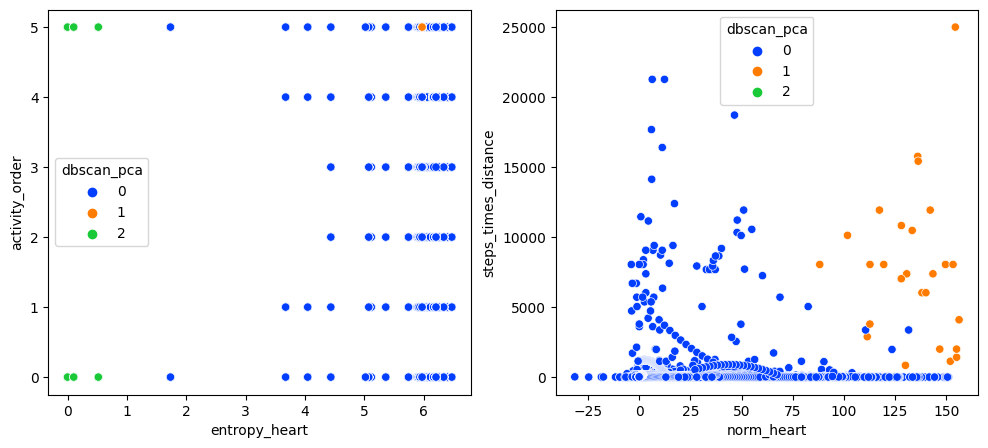

In [70]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,5))
ax1 = sns.scatterplot(data=data_noiseless, x='entropy_heart', y='activity_order',hue='dbscan_pca', palette='bright', ax=ax1)
ax2 = sns.scatterplot(data=data_noiseless, x='norm_heart', y='steps_times_distance',hue='dbscan_pca', palette='bright', ax=ax2)
plt.show()

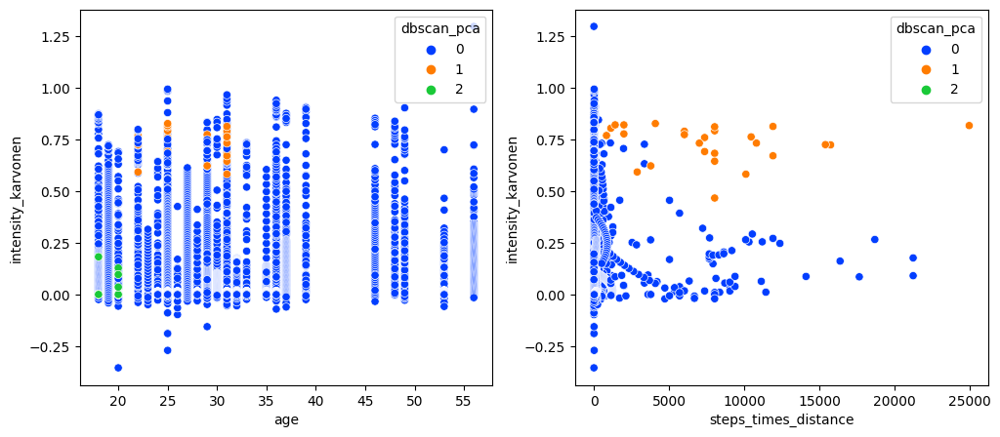

In [71]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,5))
ax1 = sns.scatterplot(data=data_noiseless, x='age', y='intensity_karvonen', hue='dbscan_pca', palette='bright', ax=ax1)
ax2 = sns.scatterplot(data=data_noiseless, x='steps_times_distance', y='intensity_karvonen', hue='dbscan_pca', palette='bright', ax=ax2)
plt.show()

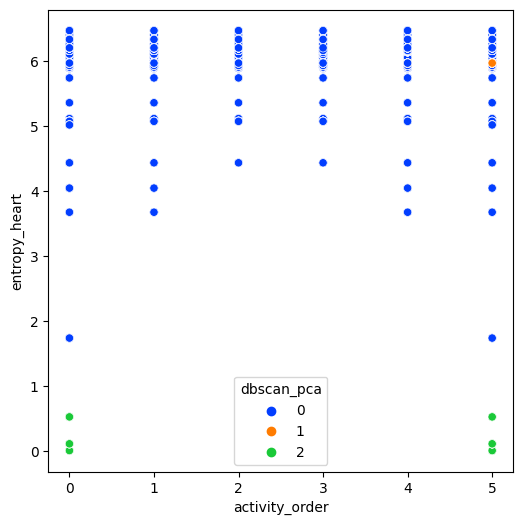

In [72]:
fig = plt.figure(figsize=(6,6))
sns.scatterplot(data=data_noiseless, x='activity_order', y='entropy_heart',hue='dbscan_pca', palette='bright')
plt.show()

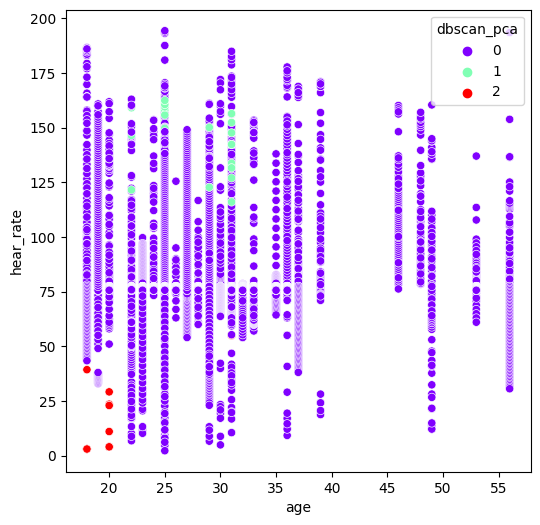

In [73]:
fig = plt.figure(figsize=(6,6))
sns.scatterplot(data=data_noiseless, x='age', y='hear_rate',hue='dbscan_pca', palette='rainbow')
plt.show()